# Práctica 6 - Eigen Faces
Aprendizaje de máquina para visión computacional 2024-2

Integrantes:

- Alejandro Mendoza Puig
- Naomi Itzel Reyes Granados
- Victor Hernández Díaz

Realizar la practica  Eigenfaces. Siguiendo la liga que se muestra ahi, vaya a la pagina donde se ve el procesamiento de Eigenfaces, baje las imágenes de Eigenfaces.

Realizar el proceso hasta antes de Face Detection. Para realizar la practica utilice la siguiente  liga que se mostro en clase:
https://sandipanweb.wordpress.com/2018/01/06/eigenfaces-and-a-simple-face-detector-with-pca-svd-in-python/



Objetivos:
1. Proyección de cada una de las caras de los integrantes del equipo aumentando el numero de eigenfaces, llegue hasta que pueda reconocer su rostro y diga cuantos eigenfaces utilizo. Averigue como realizar este proceso de proyección-reconstrucción.
2.Realice la parte de Face Morphing, la cual  es muy sencillo de implementar si se tiene la parte de reconstrucción anterior. Hacer face morphin usando 1 de las caras de los integrantes del equipo.


In [1]:
## Repositorio
! git clone https://github.com/diazhv/mlcv2024-2.git

Cloning into 'mlcv2024-2'...
remote: Enumerating objects: 5451, done.
remote: Counting objects: 100% (1099/1099), done.
remote: Compressing objects: 100% (1093/1093), done.
remote: Total 5451 (delta 11), reused 1092 (delta 5), pack-reused 4352
Receiving objects: 100% (5451/5451), 91.54 MiB | 9.17 MiB/s, done.
Resolving deltas: 100% (3267/3267), done.
Updating files: 100% (5390/5390), done.


In [83]:
import sys
import numpy as np
import matplotlib.pyplot as plt
import cv2
import os


In [84]:
def lista_archivos(path,ext_file='.tif'):
    '''
    Esta función busca dentro de un directorio especificado todas las capas con extensión **.$$$**
    y regresa una lista con la ruta de cada una de ellas.

    :param path: ruta del direcctorio que contiene las capas shape
    :type path: str

    :returns: lista con la ruta de cada capa localizada en el directorio y subdirectorios
    :rtype: list
    '''
    lista_shp=[]
    lista_names = []
    for root, dirs, files in os.walk(path):
        for name in files:
            extension = os.path.splitext(name)
            if extension[1] == ext_file:
                ruta = (root.replace("\\","/")+"/").replace("//","/")+name
                lista_names.append(name.replace(ext_file,''))
                lista_shp.append(ruta)
    return lista_shp

def l_array_imgs(path,ext=".pgm"):
  lista = lista_archivos(path,ext)
  l_imgs = []
  for p_i in lista:
    img = cv2.imread(p_i)
    if len(img.shape)>2:
      l_imgs.append(cv2.cvtColor(img, cv2.COLOR_BGR2GRAY))
    else:
      l_imgs.append(img)
  print(f'Total de imagenes encontradas: {len(lista)}')
  return l_imgs


In [109]:
path_imgs = 'mlcv2024-2/practicas/practica06/lfw1000/'

images = l_array_imgs(path_imgs,ext=".pgm")

test = l_array_imgs(path_imgs,ext=".jpg")


Total de imagenes encontradas: 1071
Total de imagenes encontradas: 2


In [86]:

min_rows, min_cols = 64,64
max_rows, max_cols = 64,64
m = len(images)
d = min_rows * min_cols
X = np.reshape(images, (m, d))

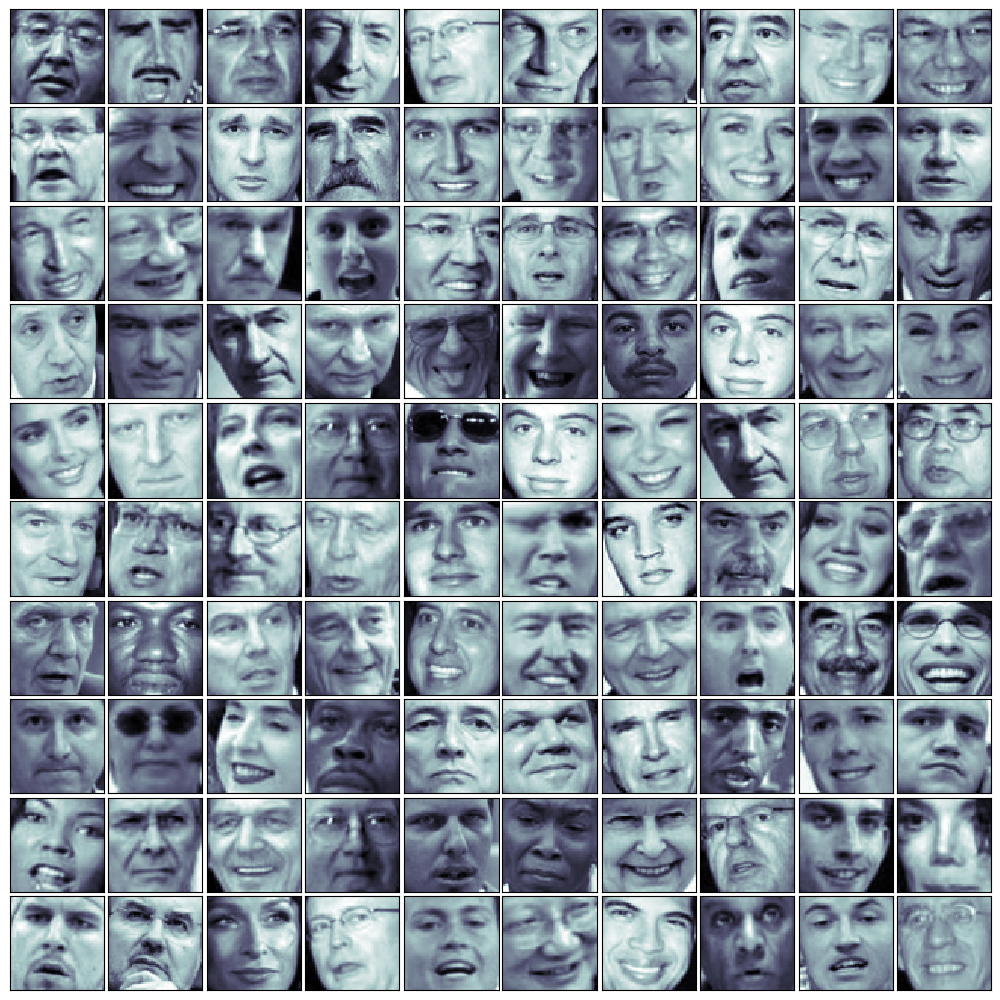

In [87]:
fig = plt.figure(figsize=(10,10))
fig.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0.05, wspace=0.05)
j = 1
np.random.seed(23)
for i in np.random.choice(range(X.shape[0]), 100):
    ax = fig.add_subplot(10, 10, j, xticks=[], yticks=[])
    ax.imshow(np.reshape(X[i,:],(64,64)), cmap=plt.cm.bone, interpolation='nearest')
    j += 1
plt.show()

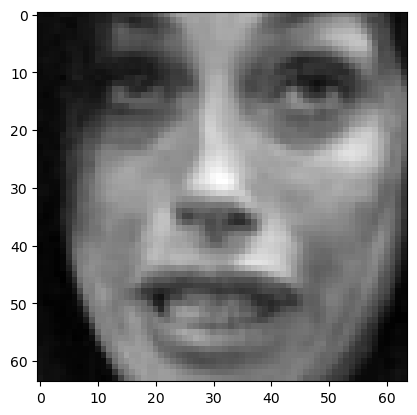

In [88]:
plt.imshow(np.reshape(X[int(len(X)/2), :], (min_rows, min_cols)),cmap='gray')

In [89]:
U, Sigma, VT = np.linalg.svd(X, full_matrices=False)
# Sanity check on dimensions
print("X:", X.shape)
print("U:", U.shape)
print("Sigma:", Sigma.shape)
print("V^T:", VT.shape)

X: (1071, 4096)
U: (1071, 1071)
Sigma: (1071,)
V^T: (1071, 4096)


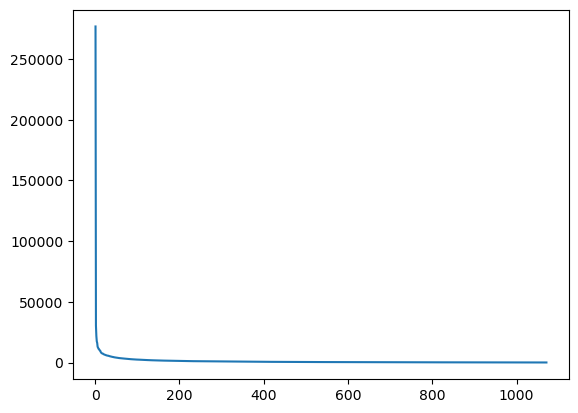

In [90]:
plt.plot([i for i in range(1,len(Sigma)+1)],Sigma)

(1071, 400)


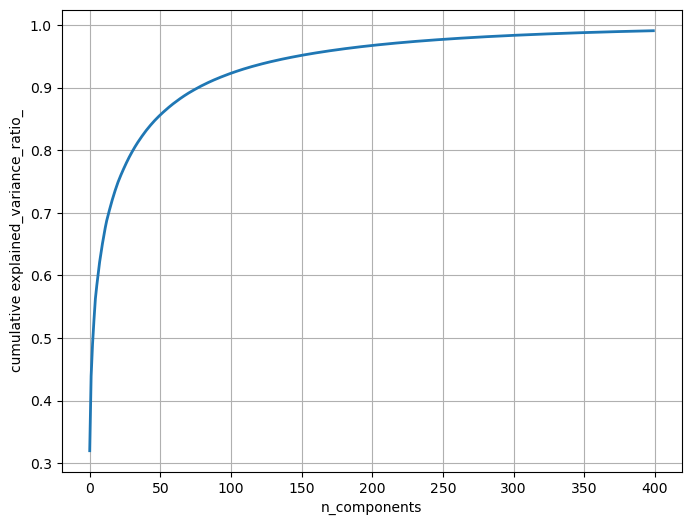

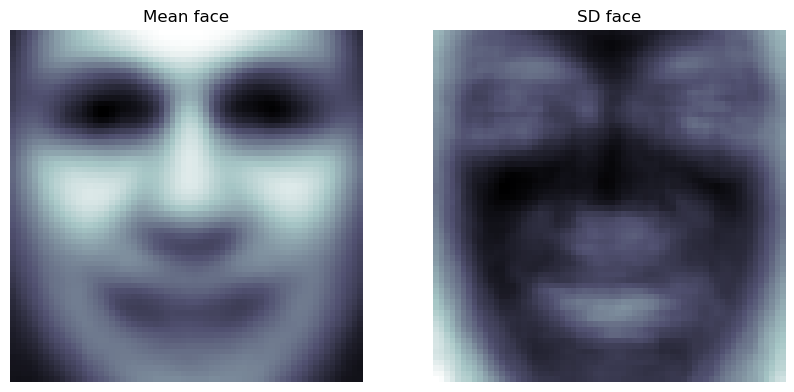

In [91]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
import pylab

n_comp =400
pipeline = Pipeline([('scaling', StandardScaler()), ('pca', PCA(n_components=n_comp))])
faces_proj = pipeline.fit_transform(X)
print(faces_proj.shape)
mean_face = np.reshape(pipeline.named_steps['scaling'].mean_, (64,64))
sd_face = np.reshape(np.sqrt(pipeline.named_steps['scaling'].var_), (64,64))
pylab.figure(figsize=(8, 6))
pylab.plot(np.cumsum(pipeline.named_steps['pca'].explained_variance_ratio_), linewidth=2)
pylab.grid(), pylab.axis('tight'), pylab.xlabel('n_components'), pylab.ylabel('cumulative explained_variance_ratio_')
pylab.show()
pylab.figure(figsize=(10,5))
pylab.subplot(121), pylab.imshow(mean_face, cmap=pylab.cm.bone), pylab.axis('off'), pylab.title('Mean face')
pylab.subplot(122), pylab.imshow(sd_face, cmap=pylab.cm.bone), pylab.axis('off'), pylab.title('SD face')
pylab.show()

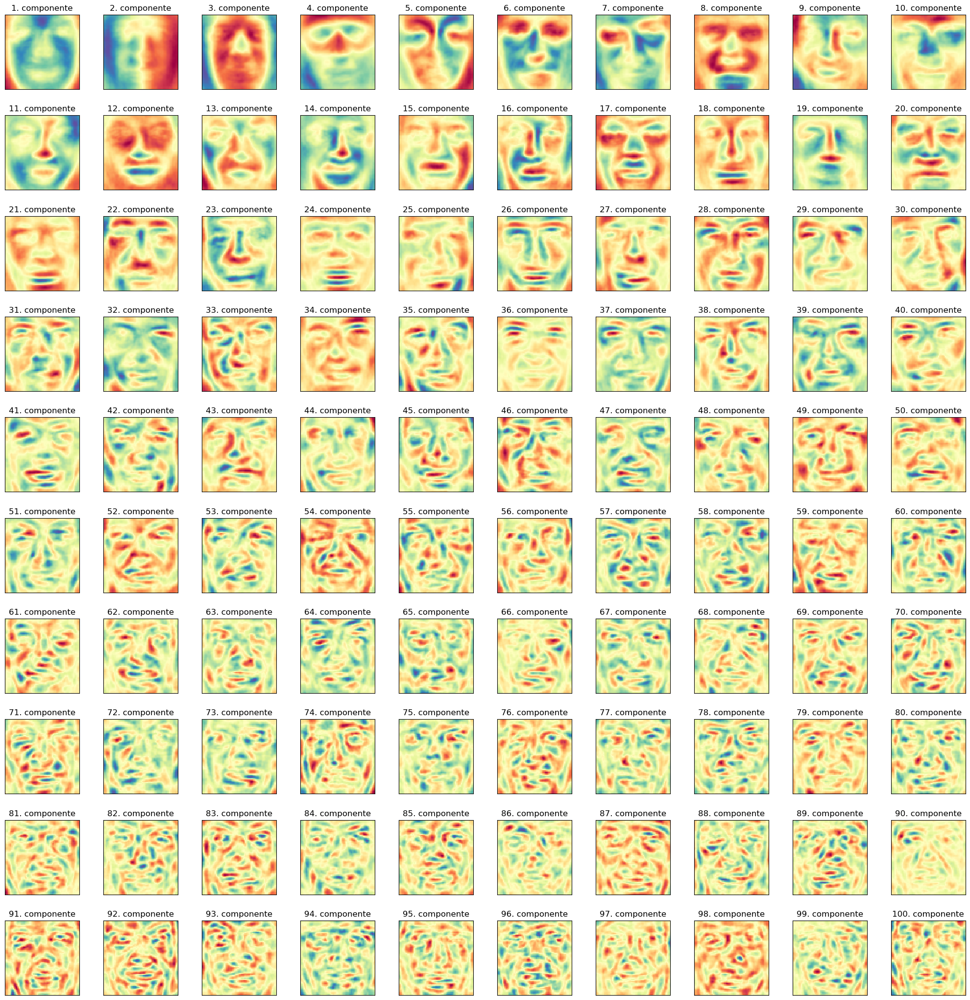

In [92]:
fig = plt.figure(figsize=(20,20))
fig.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0.35, wspace=0.05)
# plot the first 10 eigenfaces
for i in range(100):
    ax = fig.add_subplot(10, 10, i+1, xticks=[], yticks=[])
    ax.imshow(np.reshape(pipeline.named_steps['pca'].components_[i,:], (64,64)), cmap="Spectral", interpolation='nearest')
    ax.set_title(f"{i+1}. componente")

In [93]:
## Reconstruir con los eigen faces


faces_proj = pipeline.transform(test[1].reshape(1, d))


In [94]:
orig_face = test[1]
reconst_face = np.reshape(faces_proj[-1,:][:400]@pipeline.named_steps['pca'].components_[:400,:], (64,64))

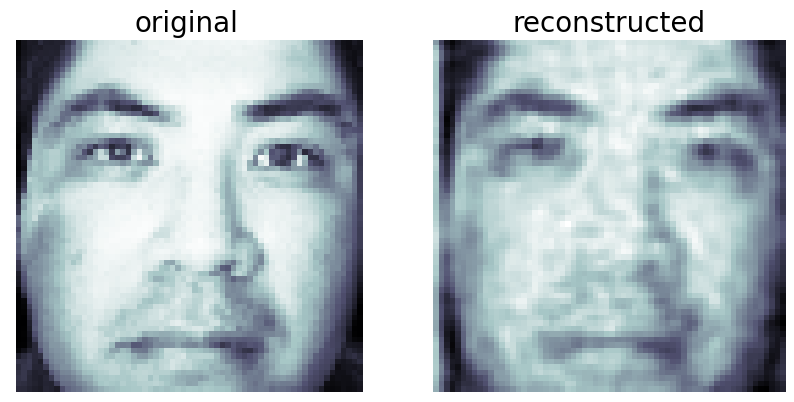

In [95]:

orig_face = test[1]
reconst_face = np.reshape(faces_proj[-1,:][:400]@pipeline.named_steps['pca'].components_[:400,:], (64,64))
reconst_face = mean_face + sd_face* reconst_face
plt.figure(figsize=(10,5))
plt.subplot(121), plt.imshow(orig_face, cmap=plt.cm.bone, interpolation='nearest'), plt.axis('off'), plt.title('original', size=20)
plt.subplot(122), plt.imshow(reconst_face, cmap=plt.cm.bone, interpolation='nearest'), plt.axis('off'), plt.title('reconstructed', size=20)
plt.show()


/var/folders/tq/3xjxdl0d4yg63z8ylzy2cs4m0000gn/T/ipykernel_997/2492295303.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(10,5))


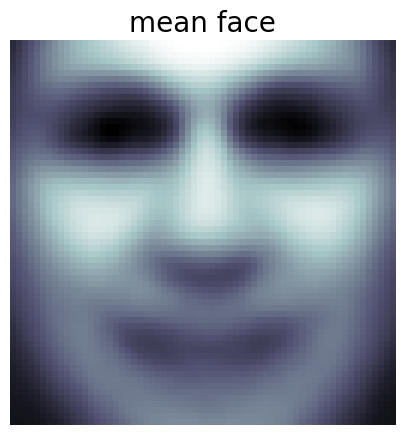

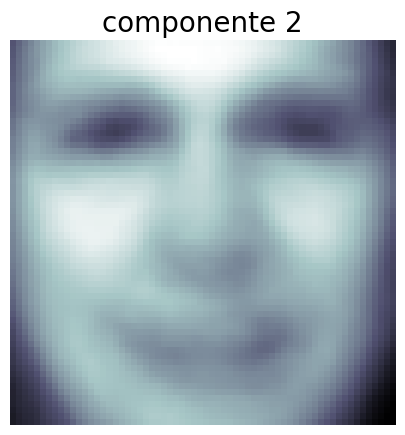

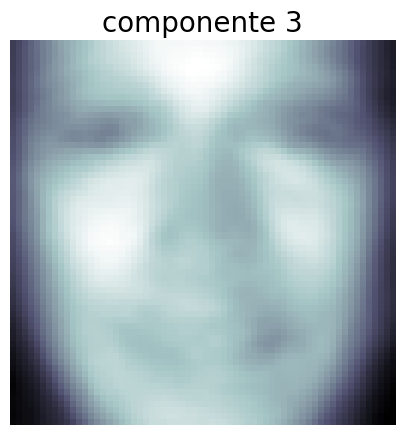

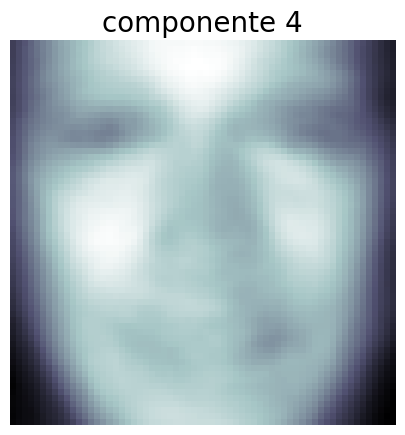

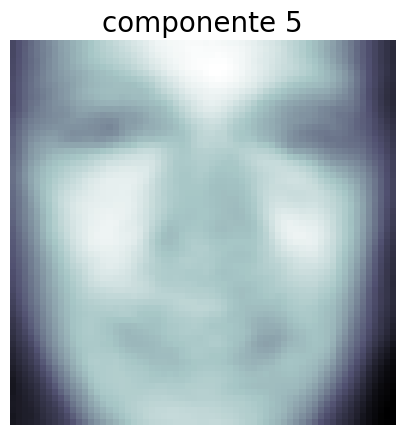

...

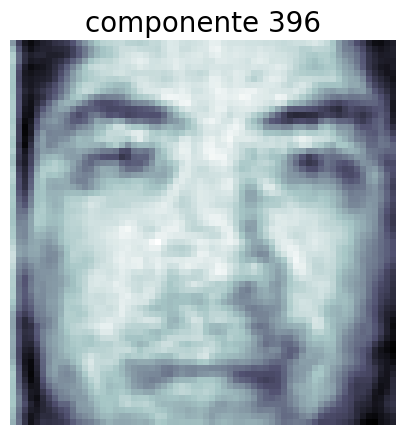

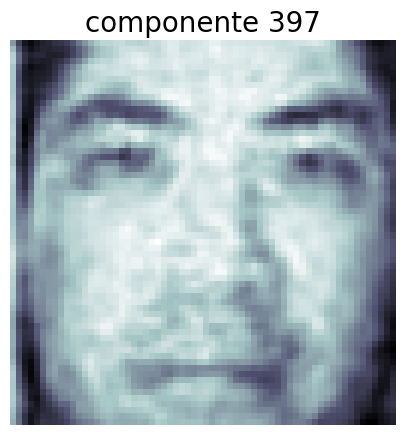

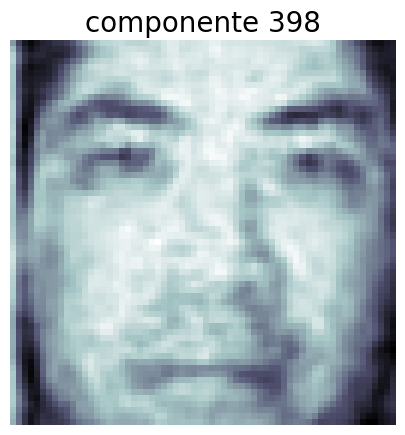

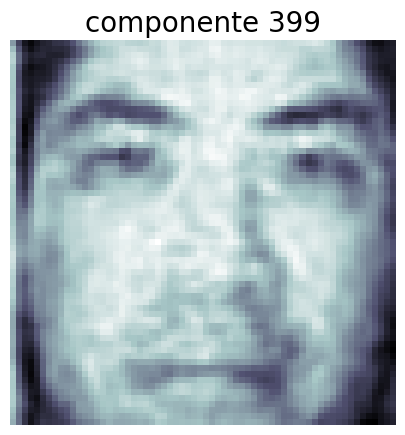

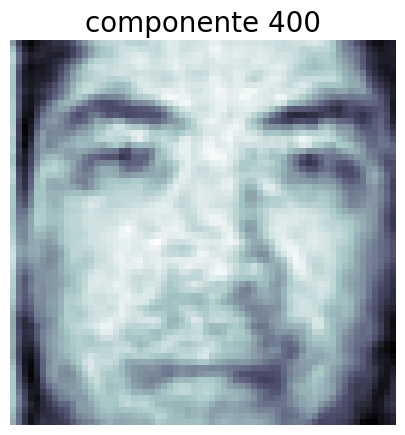

In [96]:

import imageio
from PIL import Image
resultados = []
fig = plt.figure(figsize=(10,5))
plt.imshow(mean_face, cmap=plt.cm.bone, interpolation='nearest')
plt.axis('off')
plt.title('mean face', size=20)
plt.savefig("mlcv2024-2/practicas/practica06/resultados/componente_0.png")
fig_c = Image.open("mlcv2024-2/practicas/practica06/resultados/"+f'componente_{0}'+".png")
resultados.append(fig_c)

faces_proj = pipeline.transform(test[1].reshape(1, d))

for i in range(2,401):

    reconst_face = np.reshape(faces_proj[-1,:][:i]@pipeline.named_steps['pca'].components_[:i,:], (64,64))
    reconst_face = mean_face + sd_face*reconst_face
    fig = plt.figure(figsize=(10,5))
    plt.imshow(reconst_face, cmap=plt.cm.bone, interpolation='nearest')
    plt.axis('off')
    plt.title(f'componente {i}', size=20)
    plt.savefig("mlcv2024-2/practicas/practica06/resultados/"+f'componente_{i}'+".png")
    fig_c = Image.open("mlcv2024-2/practicas/practica06/resultados/"+f'componente_{i}'+".png")
    resultados.append(fig_c)


frame_one = resultados[0]
frame_one.save('mlcv2024-2/practicas/practica06/resultados/reproyeccion.gif', format="GIF", append_images=resultados,
               save_all=True, duration=100, loop=1)


![](mlcv2024-2/practicas/practica06/resultados/reproyeccion.gif)

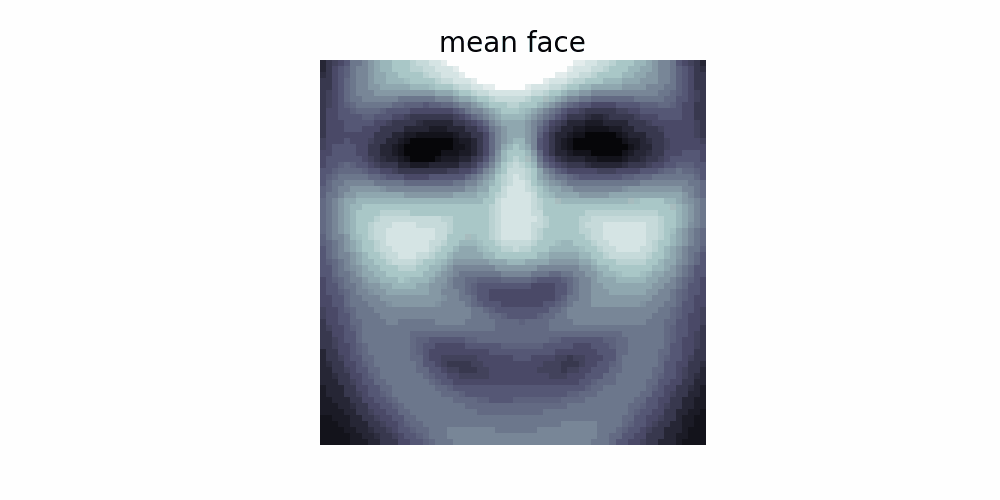

In [97]:
from IPython.display import Image
Image(open('mlcv2024-2/practicas/practica06/resultados/reproyeccion.gif','rb').read())

# Face Morphing

/var/folders/tq/3xjxdl0d4yg63z8ylzy2cs4m0000gn/T/ipykernel_997/2987543938.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(10,5))


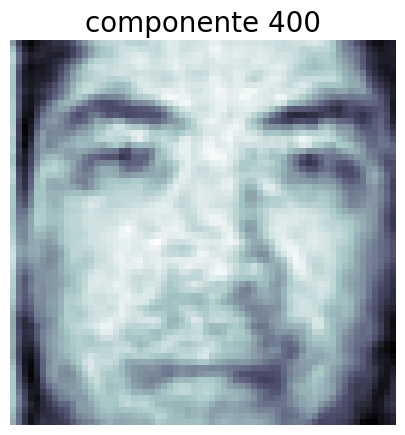

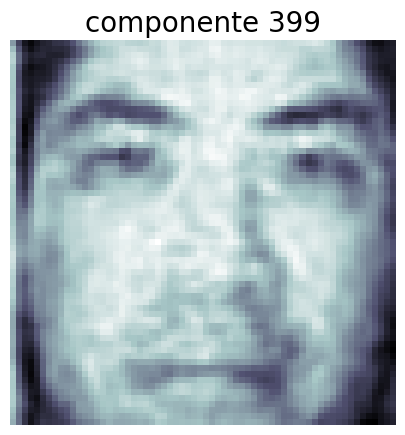

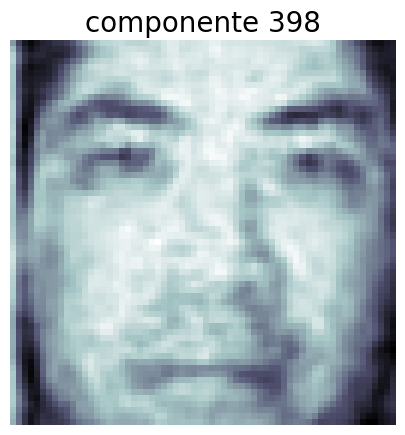

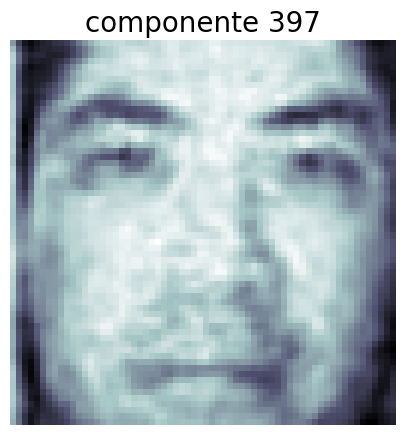

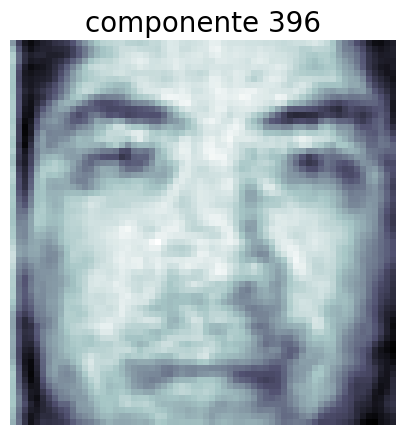

...

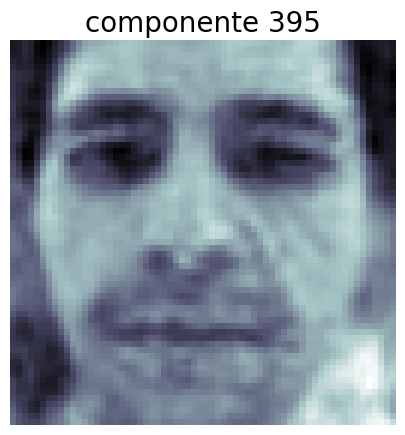

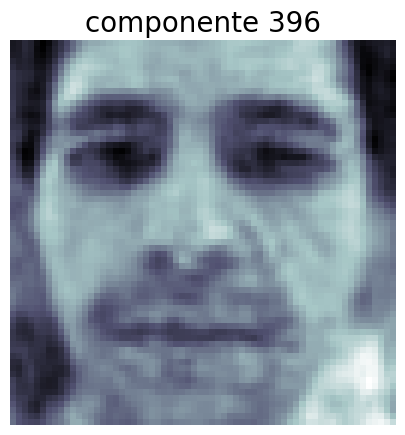

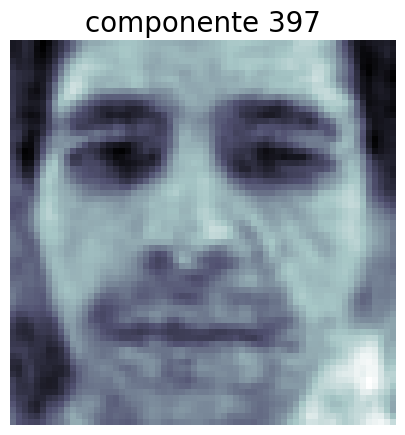

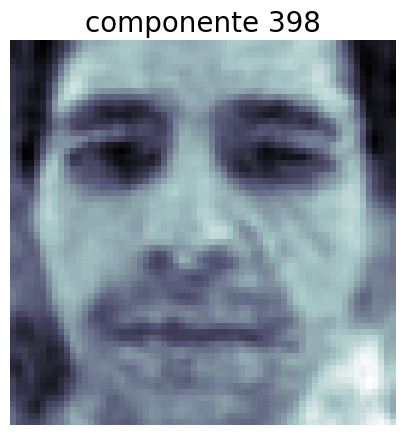

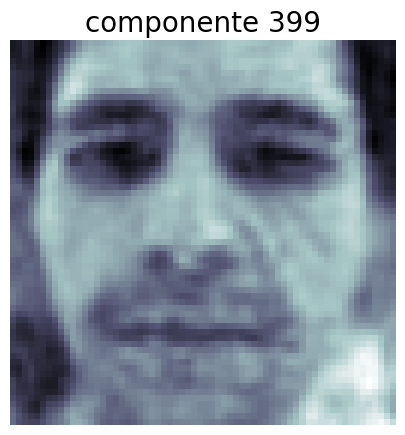

In [110]:
from PIL import Image

resultados = []

faces_proj = pipeline.transform(test[1].reshape(1, d))

for i in range(400,50,-1):
    reconst_face = np.reshape(faces_proj[-1,:][:i]@pipeline.named_steps['pca'].components_[:i,:], (64,64))
    reconst_face = mean_face + sd_face*reconst_face
    fig = plt.figure(figsize=(10,5))
    plt.imshow(reconst_face, cmap=plt.cm.bone, interpolation='nearest')
    plt.axis('off')
    plt.title(f'componente {i}', size=20)
    plt.savefig("mlcv2024-2/practicas/practica06/resultado_morph/"+f'componente_{i}'+".png")
    fig_c = Image.open("mlcv2024-2/practicas/practica06/resultado_morph/"+f'componente_{i}'+".png")
    resultados.append(fig_c)

faces_proj = pipeline.transform(test[0].reshape(1, d))

for i in range(50, 400, 1):
    reconst_face = np.reshape(faces_proj[-1,:][:i]@pipeline.named_steps['pca'].components_[:i,:], (64,64))
    reconst_face = mean_face + sd_face*reconst_face
    fig = plt.figure(figsize=(10,5))
    plt.imshow(reconst_face, cmap=plt.cm.bone, interpolation='nearest')
    plt.axis('off')
    plt.title(f'componente {i}', size=20)
    plt.savefig("mlcv2024-2/practicas/practica06/resultado_morph/"+f'componente_destino{i}'+".png")
    fig_c = Image.open("mlcv2024-2/practicas/practica06/resultado_morph/"+f'componente_destino{i}'+".png")
    resultados.append(fig_c)


frame_one = resultados[0]
frame_one.save('mlcv2024-2/practicas/practica06/resultado_morph/reproyeccion.gif', format="GIF", append_images=resultados,
               save_all=True, duration=10, loop=1)

## Referencias

Dey, S. (2018). EigenFaces and A simple Face Deterctor with PCA/SVD in python. https://sandipanweb.wordpress.com/2018/01/06/eigenfaces-and-a-simple-face-detector-with-pca-svd-in-python/

Dey, S. (2018). Hands-On Image Processing with Python: Expert Techniques for Advanced Image Analysis and Effective Interpretation of Image Data. Reino Unido: Packt Publishing.